In [1]:
import numpy as np
import pandas as pd
import scipy
from scipy import stats
import suncalc

import dask.dataframe as dd
from pathlib import Path
import glob

import datetime as dt

import matplotlib.pyplot as plt
from matplotlib import colors
import soundfile as sf
import matplotlib.patches as patches

In [2]:
import sys

sys.path.append("../src")
sys.path.append("../src/activity")

In [3]:
import subsampling as ss
import activity_assembly as actvt
from core import SITE_NAMES, FREQ_GROUPS, SEATTLE_LATITUDE, SEATTLE_LONGITUDE

from cli import get_file_paths
import plot
import pipeline
import bout as bt

In [4]:
avail = np.arange(0, 720, 3) + 3
reset_24 = avail[np.where((24*60 % avail) == 0)[0]]
reset_24

array([  3,   6,   9,  12,  15,  18,  24,  30,  36,  45,  48,  60,  72,
        90,  96, 120, 144, 180, 240, 288, 360, 480, 720])

In [5]:
cycle_lengths = reset_24
percent_ons = [1/3]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

In [6]:
data_params["dc_tags"]

['30of30',
 '1of3',
 '2of6',
 '3of9',
 '4of12',
 '5of15',
 '6of18',
 '8of24',
 '10of30',
 '12of36',
 '15of45',
 '16of48',
 '20of60',
 '24of72',
 '30of90',
 '32of96',
 '40of120',
 '48of144',
 '60of180',
 '80of240',
 '96of288',
 '120of360',
 '160of480',
 '240of720']

In [7]:
def construct_activity_arr_from_bout_metrics(bout_duration_per_interval, data_params, file_paths, dc_tag):
    """
    Construct an activity summary of the % of time occupied by bouts per date and time interval.
    Will be used later to assemble an activity summary for each duty-cycling scheme to compare effects.
    """

    time_occupied_by_bouts  = bout_duration_per_interval.values
    percent_time_occupied_by_bouts = (100*(time_occupied_by_bouts / (60*float(data_params['bin_size']))))

    all_processed_filepaths = sorted(list(map(str, list(Path(f'{file_paths["raw_SITE_folder"]}').glob('*.csv')))))
    all_processed_datetimes = pd.to_datetime(all_processed_filepaths, format="%Y%m%d_%H%M%S", exact=False)
    bout_dpi_df = pd.DataFrame(list(zip(bout_duration_per_interval.index, percent_time_occupied_by_bouts)),
                                columns=['ref_time', f'bout_time ({dc_tag})'])
    bout_dpi_df = bout_dpi_df.set_index('ref_time')
    bout_dpi_df = bout_dpi_df.reindex(index=all_processed_datetimes, fill_value=0).resample(f"{data_params['bin_size']}T").first()
    bout_dpi_df = bout_dpi_df.between_time(data_params['recording_start'], data_params['recording_end'], inclusive='left')

    return pd.DataFrame(list(zip(bout_dpi_df.index, bout_dpi_df[f'bout_time ({dc_tag})'].values)), columns=["datetime_UTC", f'bout_time ({dc_tag})'])

In [8]:
site_key = 'Telephone'
type_key = ''
print(site_key, type_key)

data_params["site_name"] = SITE_NAMES[site_key]
data_params["site_tag"] = site_key
data_params["type_tag"] = type_key

file_paths = get_file_paths(data_params)

if (pipeline_params['assemble_location_summary']):
    actvt.assemble_initial_location_summary(data_params, file_paths) ## Use to update any bd2__(location summary).csv files

activity_bouts_arr = pd.DataFrame()

for dc_tag in data_params['dc_tags']:
    # dc_tag = data_params['dc_tags'][0]
    print(dc_tag)

    location_df = ss.prepare_summary_for_plotting_with_duty_cycle(file_paths, dc_tag, data_params['bin_size'])
    bout_metrics = bt.generate_bout_metrics_for_location_and_freq(location_df, data_params, dc_tag)
    bout_duration_per_interval = actvt.get_bout_duration_per_interval(bout_metrics, data_params)
    dc_bouts = actvt.construct_activity_arr_from_bout_metrics(bout_duration_per_interval, data_params, file_paths, dc_tag)
    dc_bouts = dc_bouts.set_index("datetime_UTC")
    activity_bouts_arr = pd.concat([activity_bouts_arr, dc_bouts], axis=1)

activity_bouts_arr

Telephone 
30of30
1of3
2of6
3of9
4of12
5of15
6of18
8of24
10of30
12of36
15of45
16of48
20of60
24of72
30of90
32of96
40of120
48of144
60of180
80of240
96of288
120of360
160of480
240of720


,bout_time (30of30),bout_time (1of3),bout_time (2of6),bout_time (3of9),bout_time (4of12),bout_time (5of15),bout_time (6of18),bout_time (8of24),bout_time (10of30),bout_time (12of36),...,bout_time (30of90),bout_time (32of96),bout_time (40of120),bout_time (48of144),bout_time (60of180),bout_time (80of240),bout_time (96of288),bout_time (120of360),bout_time (160of480),bout_time (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-07-23 00:00:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
2022-07-23 00:30:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
2022-07-23 01:00:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
2022-07-23 01:30:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
2022-07-23 02:00:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-17 13:30:00,6.211222,2.7556,2.400339,1.812267,1.998839,1.449056,1.04465,4.391044,2.948578,0.047456,...,6.126222,0.0,0.0,0.0,0.0,0.0,0.0,5.887556,0.0,6.217833
2022-10-17 14:00:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
2022-10-17 14:30:00,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000


In [9]:
activity_bouts_arr.loc[dt.datetime(2022, 8, 19, 0, 0, 0):dt.datetime(2022, 8, 21, 16, 0, 0)]

,bout_time (30of30),bout_time (1of3),bout_time (2of6),bout_time (3of9),bout_time (4of12),bout_time (5of15),bout_time (6of18),bout_time (8of24),bout_time (10of30),bout_time (12of36),...,bout_time (30of90),bout_time (32of96),bout_time (40of120),bout_time (48of144),bout_time (60of180),bout_time (80of240),bout_time (96of288),bout_time (120of360),bout_time (160of480),bout_time (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-08-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-19 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-19 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-21 13:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-21 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-21 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
high_actvt_btp = activity_bouts_arr.loc[dt.datetime(2022, 8, 19, 0, 0, 0):dt.datetime(2022, 8, 21, 16, 0, 0)].copy()

for col_name in high_actvt_btp.columns:
    dc_tag = col_name.split('(')[-1].split(')')[0]
    on = int(dc_tag.split('of')[0])
    total = int(dc_tag.split('of')[-1])
    bin_size = int(data_params['bin_size'])
    dc_actvt = high_actvt_btp[col_name].copy()


    recover_ratio = min(total, bin_size) / min(on, bin_size)
    rep_dc_actvt = dc_actvt * recover_ratio

    if total-on >= bin_size:
        print(dc_tag)
        high_actvt_btp[col_name] = rep_dc_actvt.replace(np.NaN, -1).replace(0, np.NaN).ffill(limit=(min((14*60)-on, total-on)//bin_size)).replace(np.NaN, 0).replace(-1, np.NaN)
    else:
        high_actvt_btp[col_name] = rep_dc_actvt

15of45
16of48
20of60
24of72
30of90
32of96
40of120
48of144
60of180
80of240
96of288
120of360
160of480
240of720


In [11]:
high_actvt_btp

,bout_time (30of30),bout_time (1of3),bout_time (2of6),bout_time (3of9),bout_time (4of12),bout_time (5of15),bout_time (6of18),bout_time (8of24),bout_time (10of30),bout_time (12of36),...,bout_time (30of90),bout_time (32of96),bout_time (40of120),bout_time (48of144),bout_time (60of180),bout_time (80of240),bout_time (96of288),bout_time (120of360),bout_time (160of480),bout_time (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-08-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-21 13:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.391406,0.391406,0.391406,0.391406,0.045339,0.391406,5.9845,0.391406
2022-08-21 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.391406,0.391406,0.391406,0.045339,0.391406,5.9845,0.391406
2022-08-21 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.000000,0.391406,0.391406,0.000000,0.391406,5.9845,0.391406


In [12]:
exp_dc_btp = high_actvt_btp.mean()[1:]
control_dc_btp = high_actvt_btp.mean()[0]

In [13]:
exp_dc_btp

bout_time (1of3)        13.640180
bout_time (2of6)        13.567290
bout_time (3of9)        14.070620
bout_time (4of12)       13.208958
bout_time (5of15)       13.660713
bout_time (6of18)       13.200390
bout_time (8of24)       12.221026
bout_time (10of30)      12.017206
bout_time (12of36)      11.610281
bout_time (15of45)      14.803247
bout_time (16of48)       9.893037
bout_time (20of60)      15.058025
bout_time (24of72)       8.910499
bout_time (30of90)      13.651975
bout_time (32of96)       4.539809
bout_time (40of120)      6.530750
bout_time (48of144)     12.585546
bout_time (60of180)     16.224400
bout_time (80of240)     15.103327
bout_time (96of288)      6.587956
bout_time (120of360)    10.915884
bout_time (160of480)    16.054136
bout_time (240of720)    12.760408
dtype: float64

In [14]:
time_ons = []
c_lengths = []
for col_name in exp_dc_btp.index:
    dc_tag = col_name.split('(')[-1].split(')')[0]
    on = int(dc_tag.split('of')[0])
    total = int(dc_tag.split('of')[-1])
    time_ons.append(on)
    c_lengths.append(total)

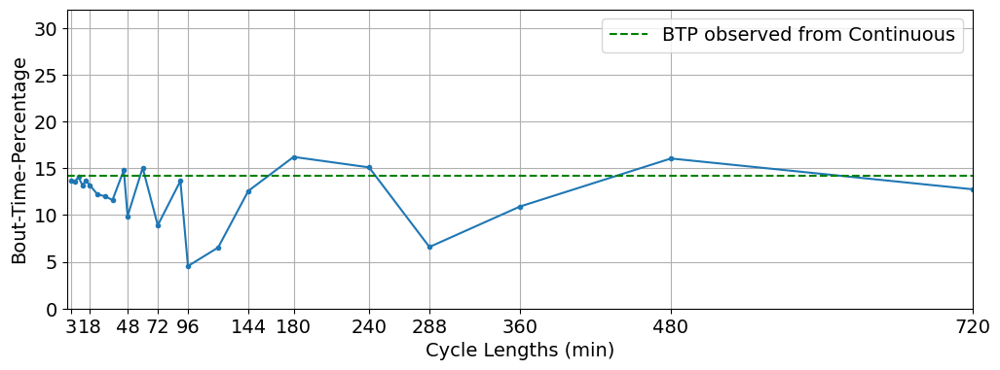

In [23]:
plt.figure(figsize=(12, 4))
plt.rcParams.update({'font.size':14})
plt.plot(c_lengths, exp_dc_btp,  marker='.')
plt.axhline(control_dc_btp, linestyle='dashed', color='g', label=f'BTP observed from Continuous')
plt.xlabel('Cycle Lengths (min)')
plt.ylabel('Bout-Time-Percentage')
plot_log_labels = np.concatenate([c_lengths[:8], c_lengths[8:16:2], c_lengths[16:20:2], c_lengths[20:]]).astype('int')
plot_lin_labels = np.concatenate([c_lengths[:10:5], c_lengths[10:16:2], c_lengths[16::]]).astype('int')
# plt.xscale('log')
# plt.xlim(2**np.floor(np.log2(time_ons[0])), 
#          2**np.ceil(np.log2(time_ons[-1])))
plt.xlim(0, c_lengths[-1])
plt.xticks(plot_lin_labels, plot_lin_labels)
plt.ylim(0, 2**np.ceil(np.log2(exp_dc_btp.max())))
plt.legend()
plt.grid(which='both')
plt.show()

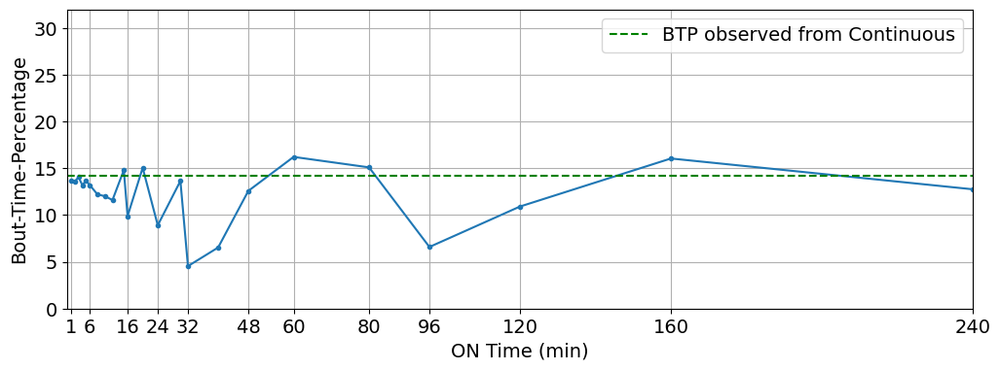

In [22]:
plt.figure(figsize=(12, 4))
plt.rcParams.update({'font.size':14})
plt.plot(time_ons, exp_dc_btp,  marker='.')
plt.axhline(control_dc_btp, linestyle='dashed', color='g', label=f'BTP observed from Continuous')
plt.xlabel('ON Time (min)')
plt.ylabel('Bout-Time-Percentage')
plot_log_labels = np.concatenate([time_ons[:8], time_ons[8:16:2], time_ons[16:20:2], time_ons[20:]]).astype('int')
plot_lin_labels = np.concatenate([time_ons[:10:5], time_ons[10:16:2], time_ons[16::]]).astype('int')
# plt.xscale('log')
# plt.xlim(2**np.floor(np.log2(time_ons[0])), 
#          2**np.ceil(np.log2(time_ons[-1])))
plt.xlim(0, time_ons[-1])
plt.xticks(plot_lin_labels, plot_lin_labels)
plt.ylim(0, 2**np.ceil(np.log2(exp_dc_btp.max())))
plt.legend()
plt.grid(which='both')
plt.show()

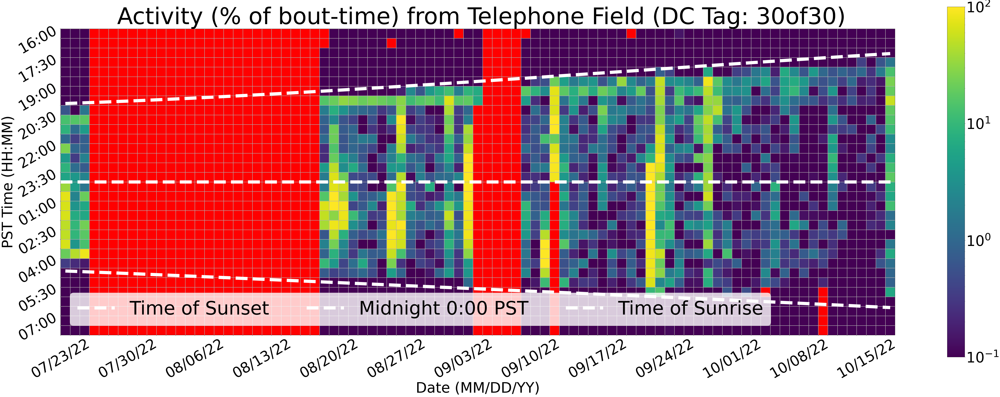

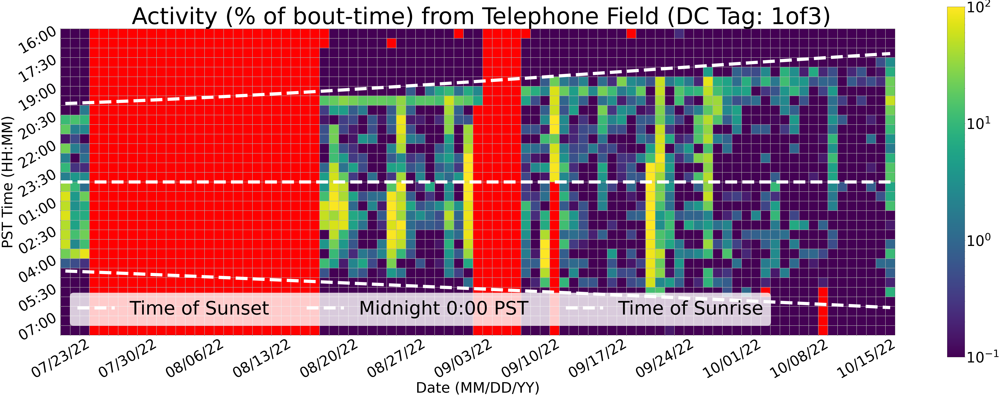

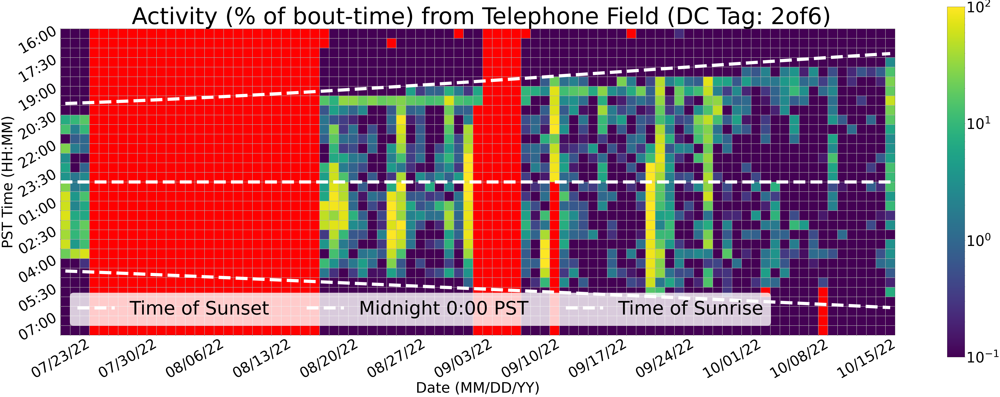

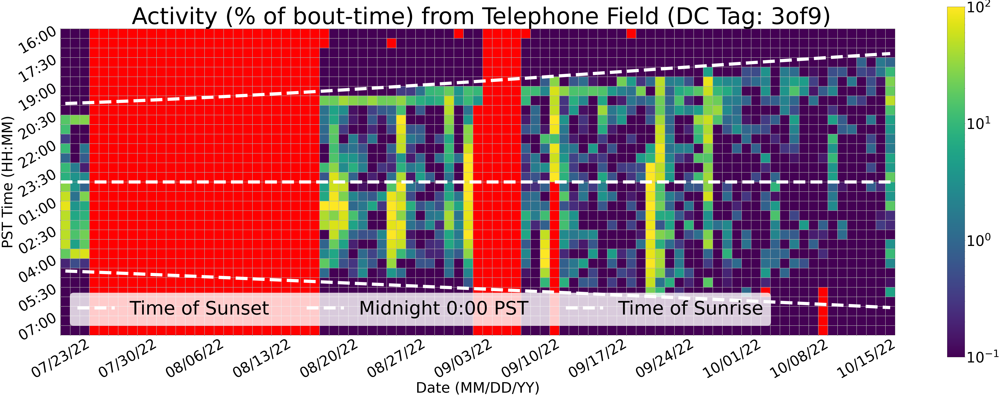

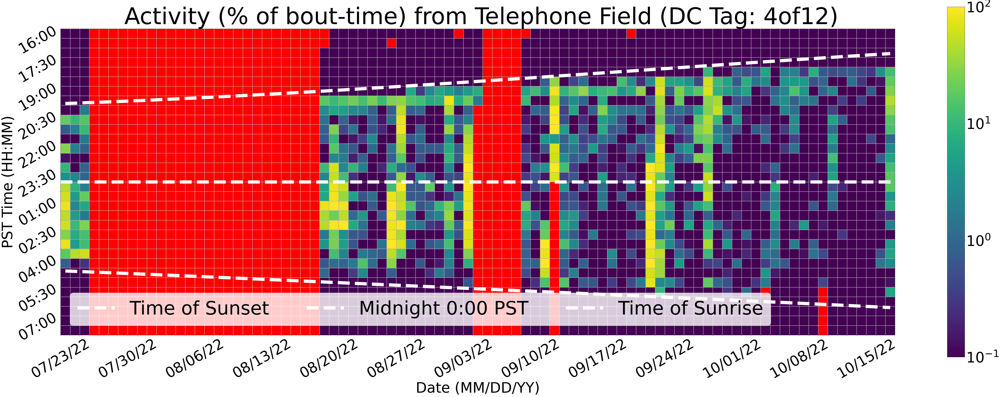

...

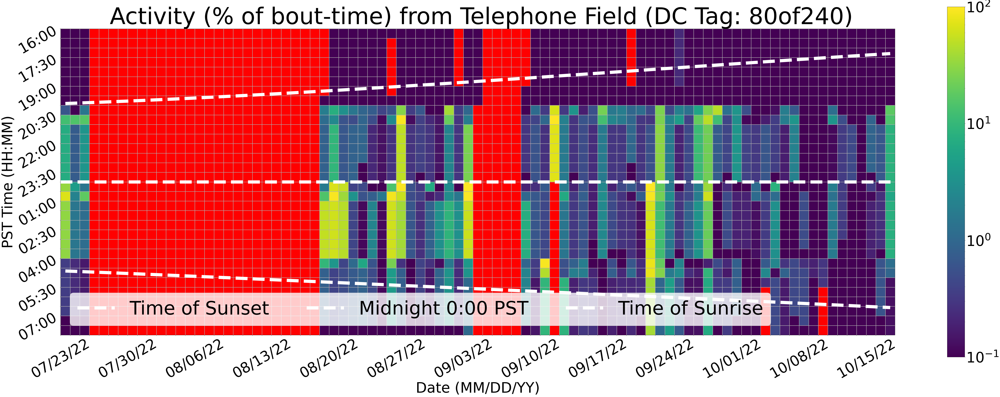

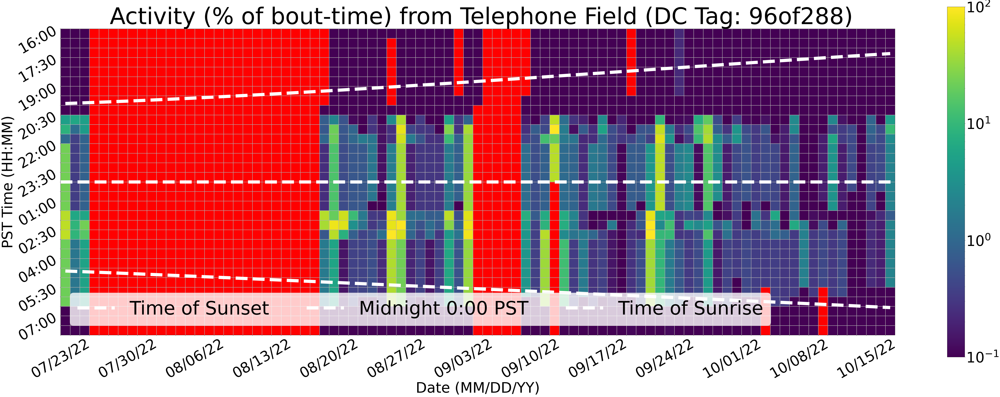

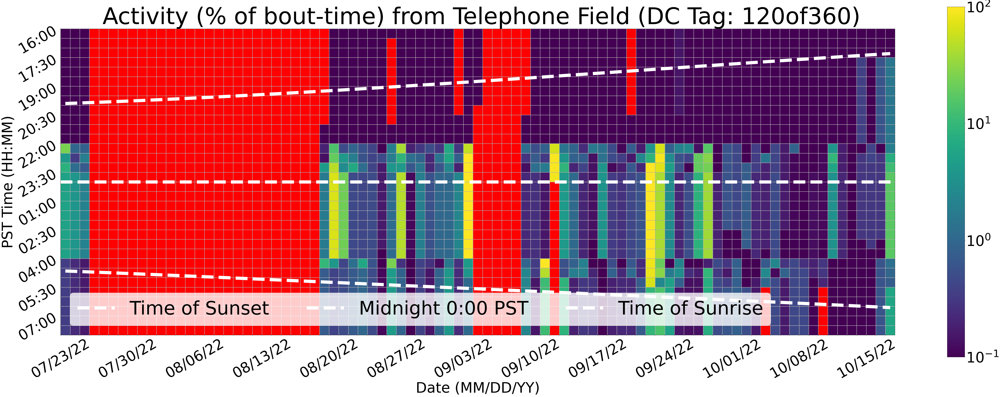

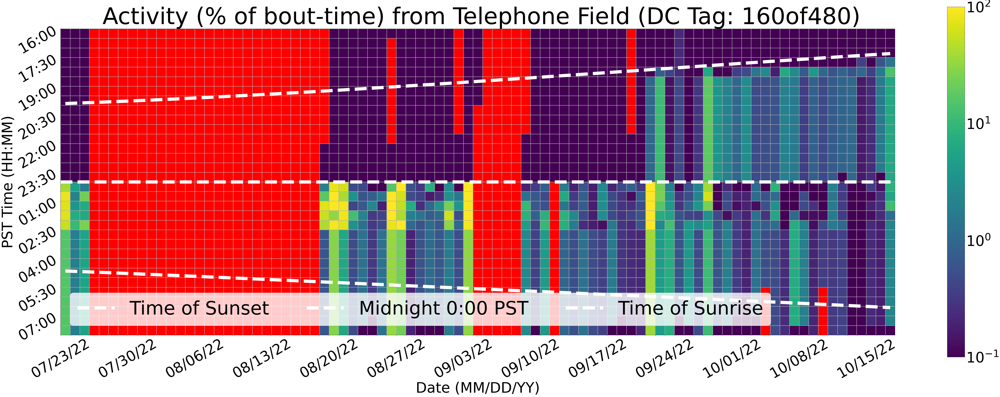

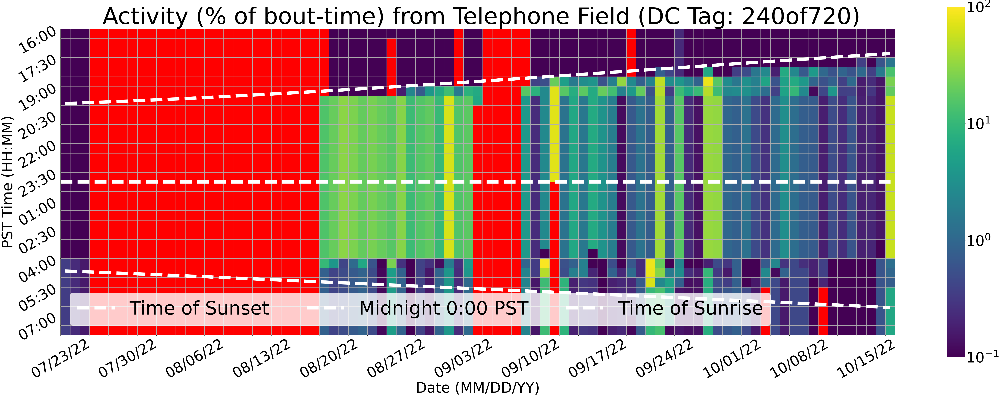

In [17]:
for dc_tag in dc_tags:
    data_params["cur_dc_tag"] = dc_tag
    plot.plot_activity_grid_for_bouts(activity_bouts_arr, data_params, pipeline_params, file_paths)